In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io

import IPython.display
from IPython.display import Audio

from raster import raster

In [4]:
data = scipy.io.loadmat("../ra/ConcatSongSpikesAndLFP_SongSpikesAndLFP_2015_06_24_08_41_27_225.mat")

In [15]:
song_data = data["SongData"]
sample_rate = data["SF"][0, 0]
lfp_sample_rate = data["LFPSF"][0, 0]

In [36]:
def plot_song_and_spikes(t_range):
    """
    Plot song waveform, spike trains, and LFP for given index range
    """
    # First compute the song, spike trains, and LFP
    ind_range = (t_range * sample_rate).astype(int)
    lfp_ind_range = ind_range * lfp_sample_rate / sample_rate
    
    unit_spikes = []
    for spikes in data["SpikeTimes"][0]:
        spikes = spikes.flatten()
        unit_spikes.append(spikes[
                np.where((t_range[0] < spikes) *(t_range[1] > spikes))
            ])
    
    LFP = data["LFP"][:3, 0]
    song_portion = song_data[ind_range[0]:ind_range[1]]

    plt.figure(figsize=(20, 15))
    
    # song subplot
    plt.subplot(3, 1, 1)
    plt.plot(np.arange(*ind_range), song_portion)
    plt.xlim(*ind_range)
    
    # spikes subplot
    plt.subplot(3, 1, 2)
    raster(unit_spikes)
    plt.xlim(*t_range)

    # LFP subplot
    plt.subplot(3, 1, 3)
    for lfp in LFP:
        plt.plot(lfp[lfp_ind_range[0]:lfp_ind_range[1]])
    plt.show()

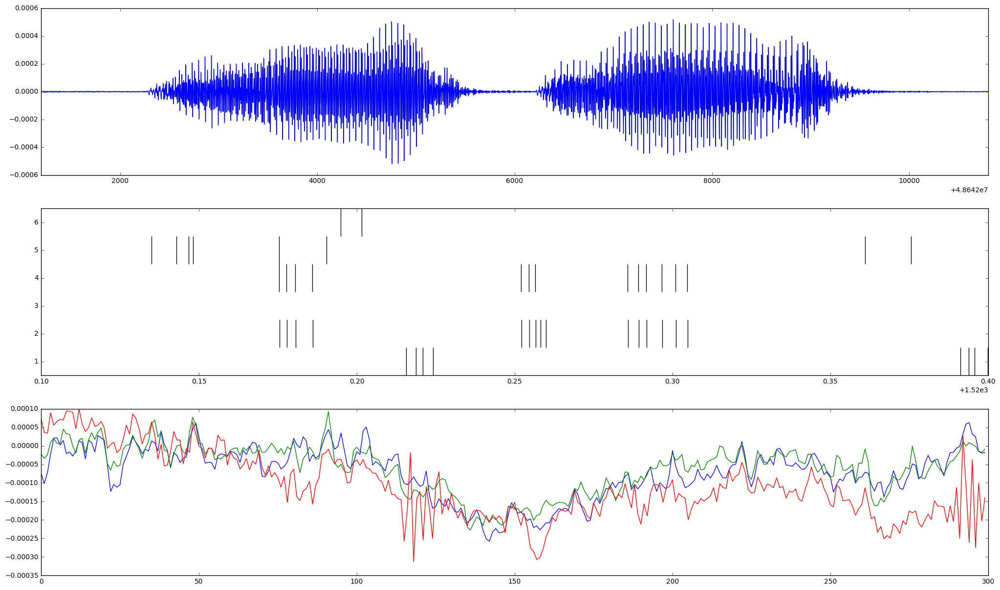

In [18]:
t_range = np.array([25 * 60 + 10, 25 * 60 + 35])
t_range = np.array([25 * 60 + 20.1, 25 * 60 + 20.4])

plot_song_and_spikes(t_range)

In [42]:
def find_songs(song_data, threshold=2e-4, step=100000):
    """
    Find pairs of indicies bounding songs
    """
    window_ranges = []
    in_window = False

    for i in range(0, len(song_data), step):
        max_in_window = np.max(song_data[i:i+step])
        if max_in_window > threshold:
            if in_window:
                window_ranges[-1][1] = i + step
            else:
                window_ranges.append([i-50000, i+step])
                in_window = True
        else:
            in_window = False

    return np.array(window_ranges)
    
def indices_to_time(ind):
    return ind / float(sample_rate)

In [43]:
window_ranges = find_songs(song_data)

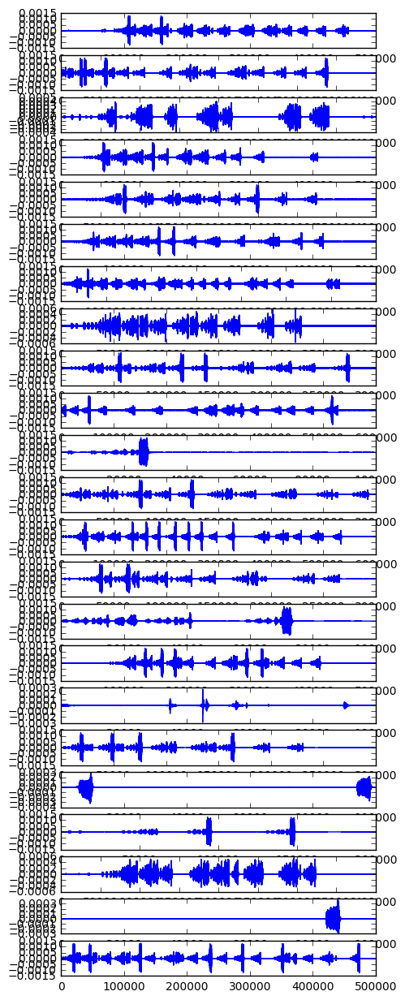

In [25]:
showing = 30
plt.figure(figsize=(5, 20))
for i, block in enumerate(window_ranges[:showing]):
    plt.subplot(showing, 1, i+1)
    plt.plot(data["SongData"][range(*block)])
plt.show()

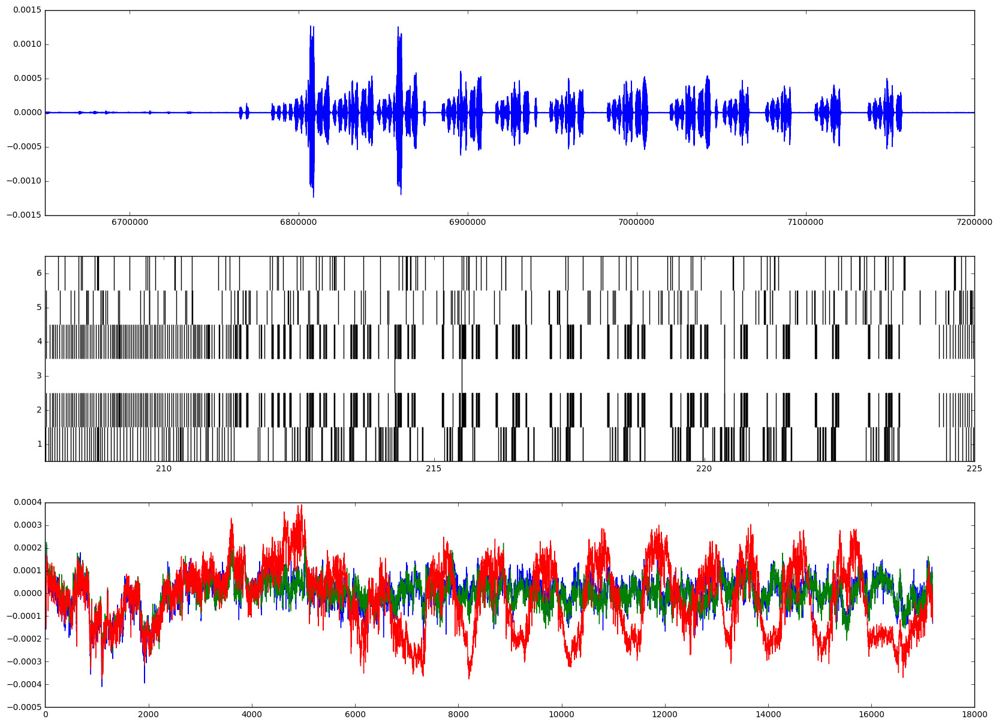

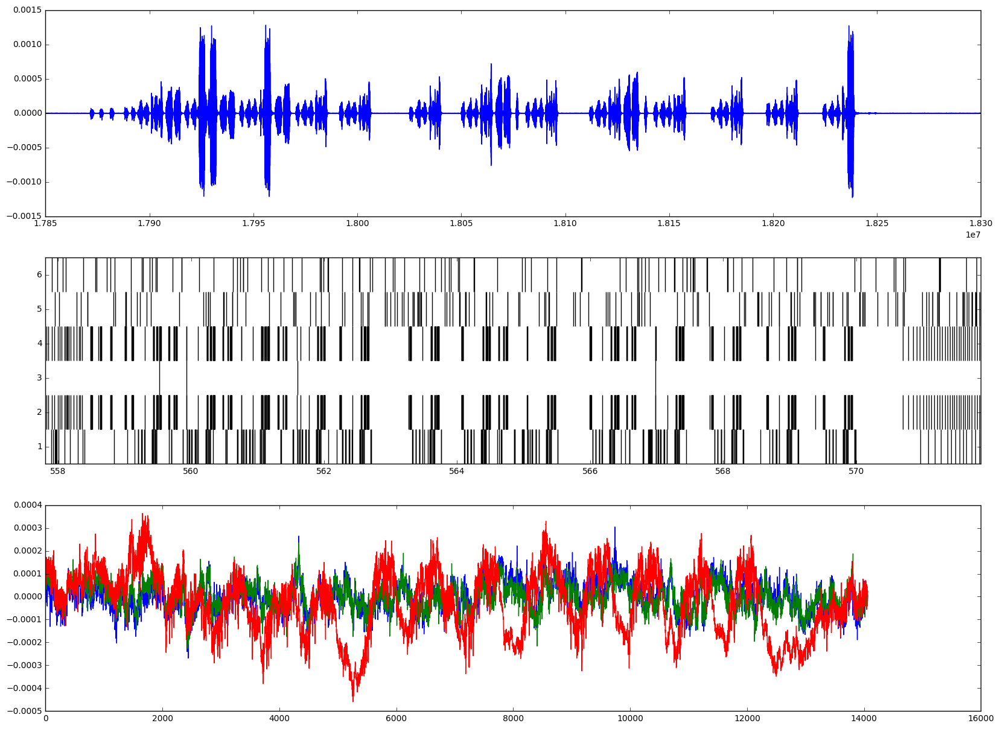

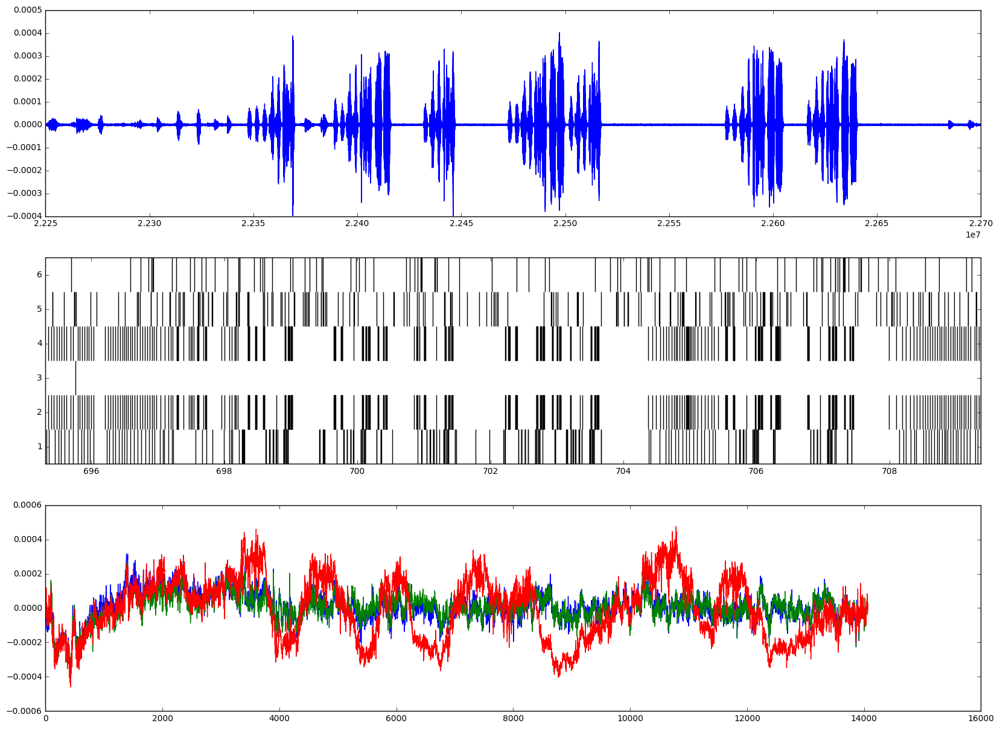

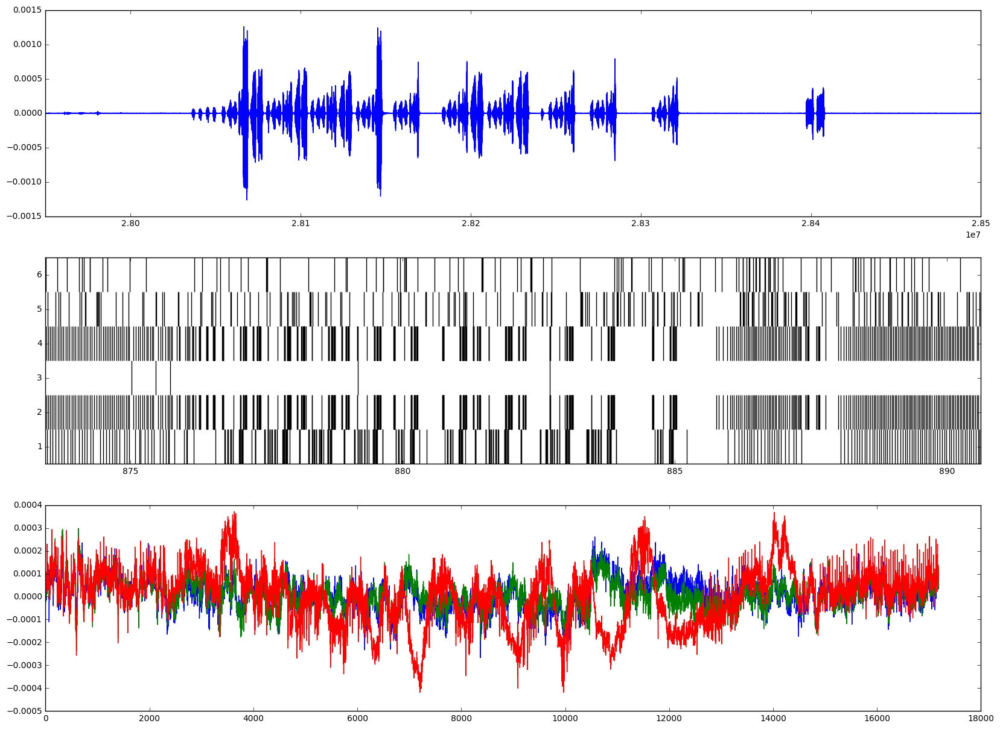

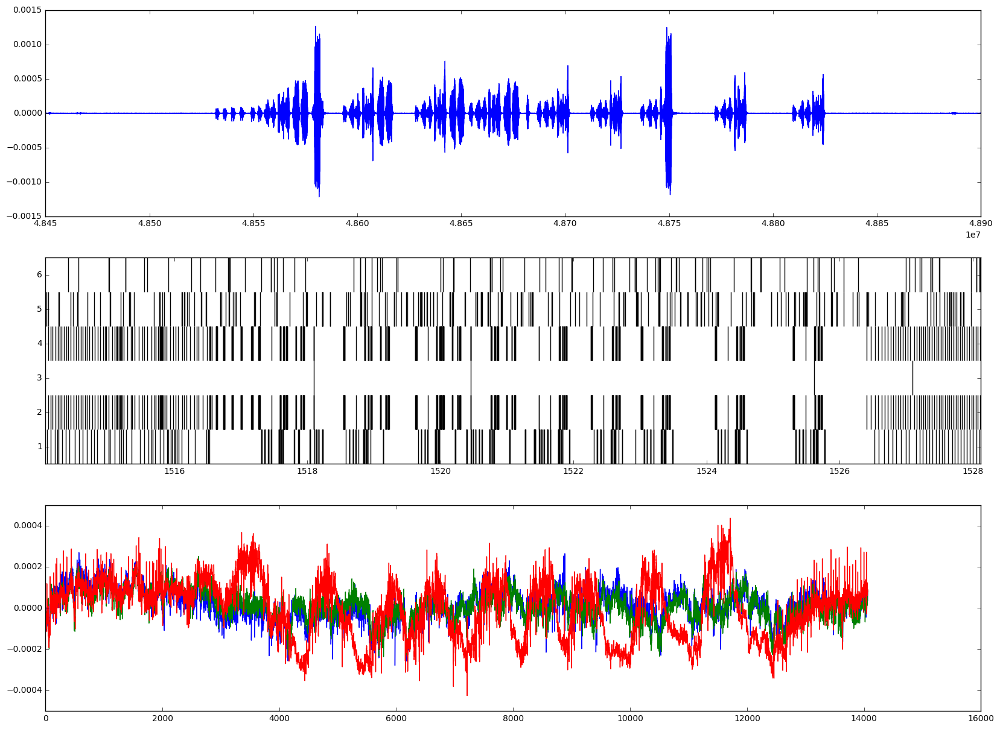

...

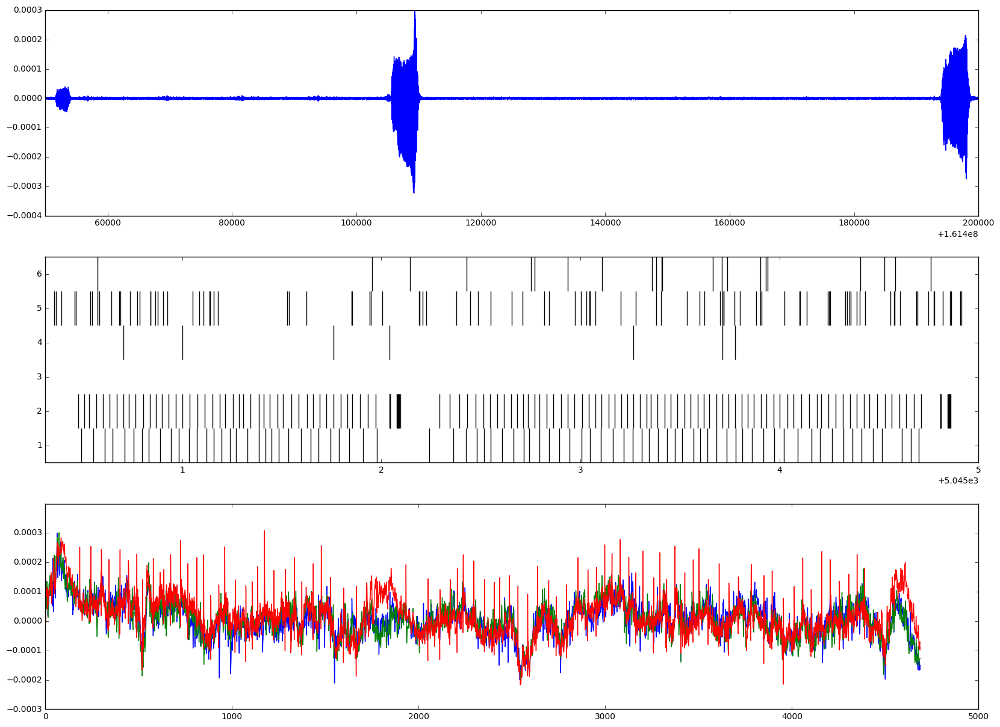

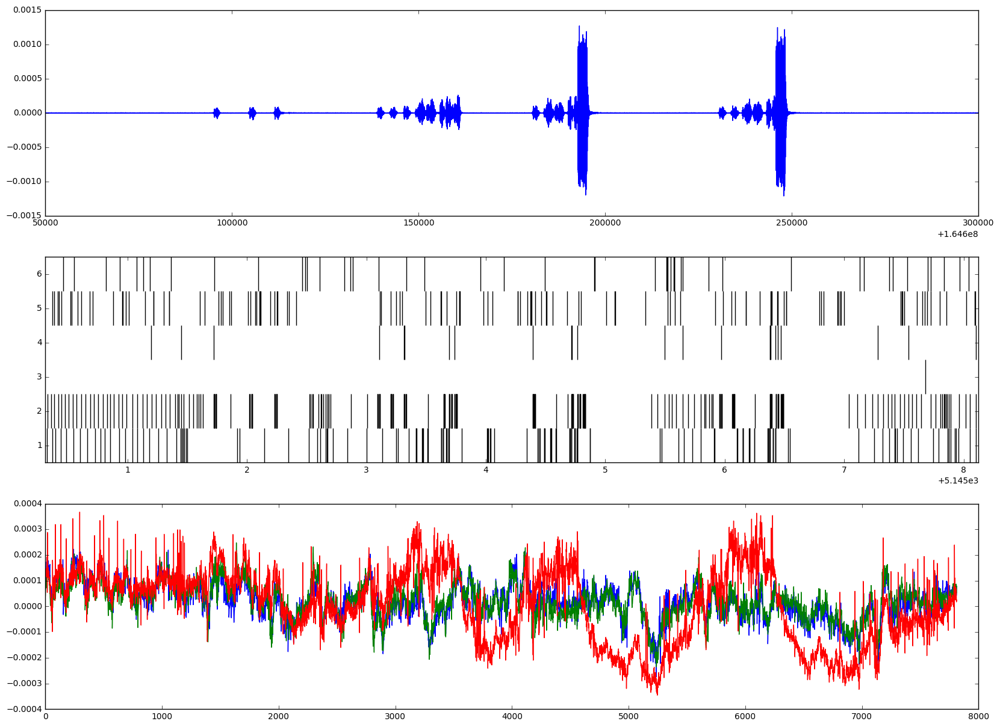

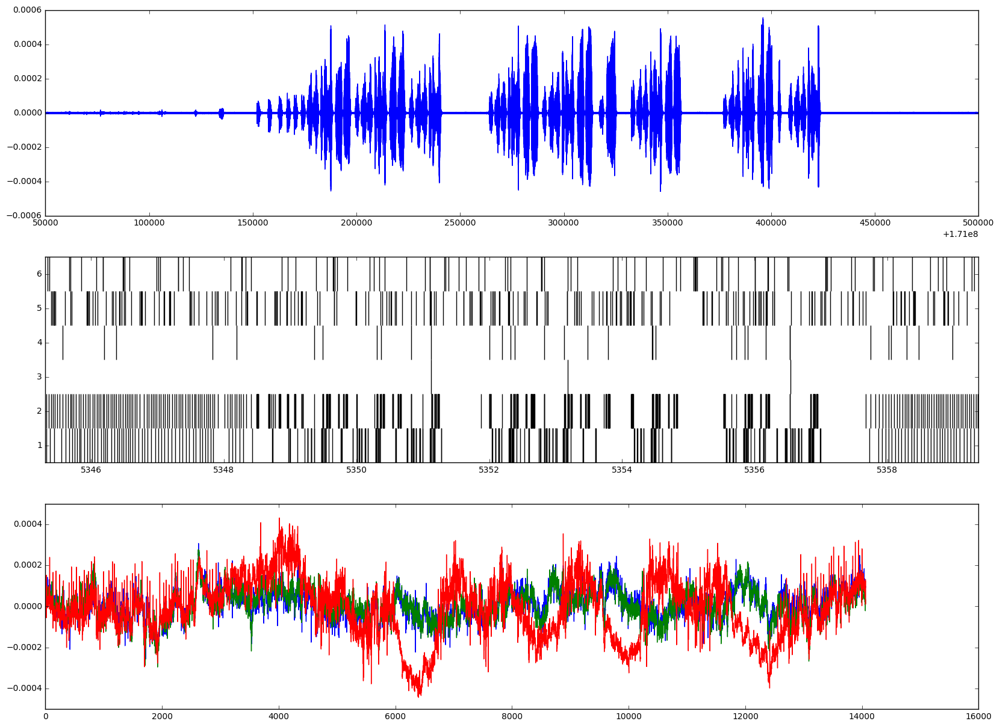

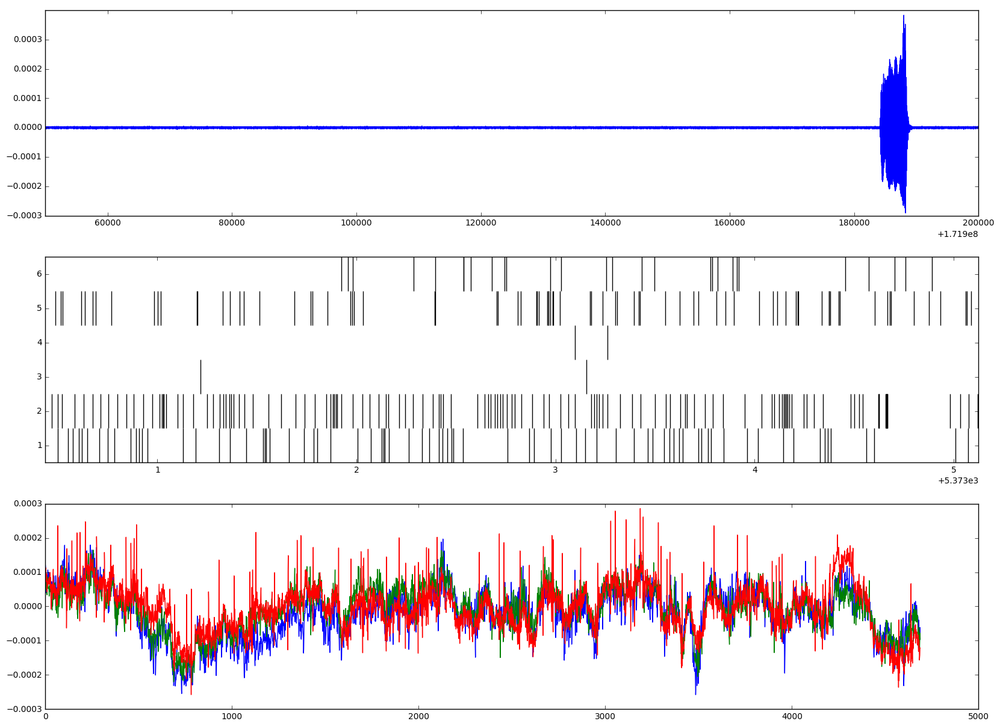

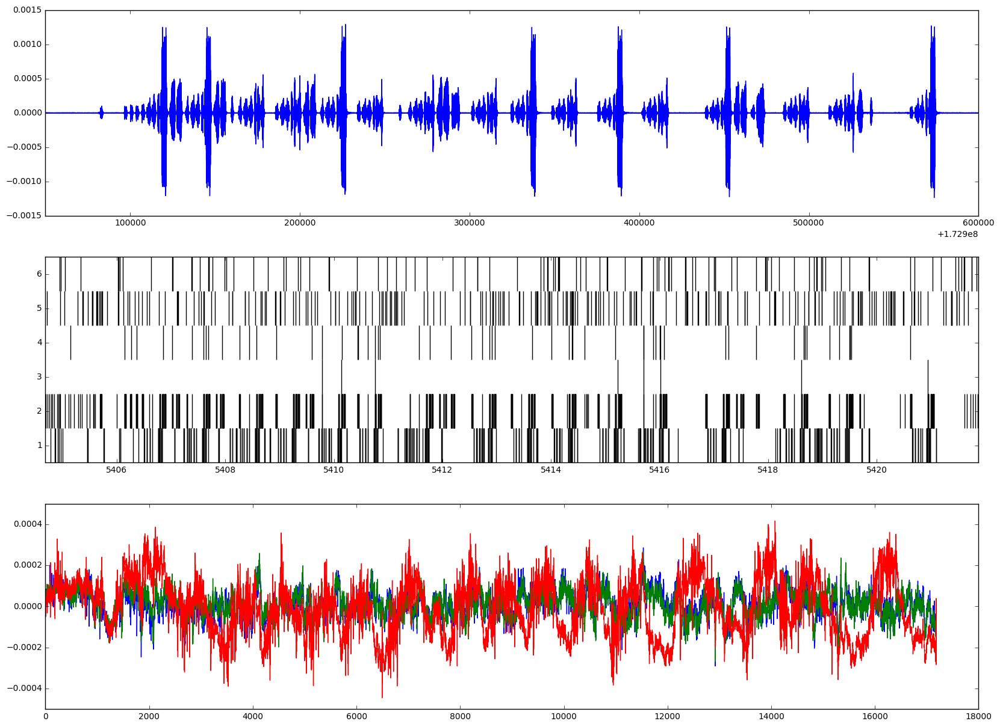

In [44]:
for window in window_ranges:
    IPython.display.display(Audio(data["SongData"][range(*window)].T, rate=sample_rate))
    plot_song_and_spikes(indices_to_time(window))
